### Libraries installations

In [0]:
%pip install xgboost
%pip install transformers
%pip install torch
%pip install optuna

Python interpreter will be restarted.
Python interpreter will be restarted.
Python interpreter will be restarted.
  Using cached fsspec-2024.3.1-py3-none-any.whl (171 kB)
Python interpreter will be restarted.
Python interpreter will be restarted.
  Using cached torch-2.2.2-cp39-cp39-manylinux1_x86_64.whl (755.5 MB)
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (99 kB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_nccl_cu12-2.19.3-py3-none-manylinux1_x86_64.whl (166.0 MB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  U

### Required imports

In [0]:
from pyspark.sql.types import *
import pyspark
import pandas as pd
import numpy as np
import pyspark.sql.functions as F
from datetime import datetime, timedelta
import time
import optuna


from pyspark.sql import SparkSession
spark = SparkSession.builder.getOrCreate()

from pyspark.ml import Pipeline
from pyspark.ml.feature import VectorAssembler
from pyspark.ml.regression import LinearRegression, DecisionTreeRegressor, RandomForestRegressor, GBTRegressor
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml.tuning import CrossValidator, ParamGridBuilder
from pyspark.ml.feature import (RegexTokenizer, StopWordsRemover, CountVectorizer, IDF, OneHotEncoder,
                                StringIndexer, VectorAssembler, MinMaxScaler, IndexToString)

## Load the dataset after data imputation

In [0]:
original_dataset = spark.read.parquet("/FileStore/g45/imputed_df.parquet")

In [0]:
display(original_dataset)
print(original_dataset.count())

name,clean_company_name,exp_title,exp_months,rating,happiness,roles,company_count,meta_industry,employees,total_exp,avg_exp,last_exp,has_bachelor,has_master,has_doctor,is_intern
. Ranjan,mastercard,senior product manager in technical,12.0,3.95,73.0999984741211,4.699999809265137,0,Financial and Investment,"10,000+",0,0.0,0,0,0,0,0
. Ranjan,tech mahindra,sr. test engineer,21.0,3.55,68.5,4.5,1,Technology,"10,000+",12,12.0,12,0,0,0,0
A Rao Lade,apple,program manager/ team lead,22.0,4.05,79.0999984741211,5.0,0,Retail and Consumer Goods,"10,000+",0,0.0,0,1,1,0,0
A Rao Lade,microsoft,senior business program manager,68.0,4.0,81.5999984741211,5.0,1,Technology,"10,000+",22,22.0,22,1,1,0,0
A. Abdul Ahad,levi strauss co,scrum master/project manager,12.0,3.75,70.92342028216142,4.800000190734863,0,Retail and Consumer Goods,"10,000+",0,0.0,0,1,1,0,0
A. Abdul Ahad,nike,scrum master/project manager,18.0,4.0,78.19999694824219,5.0,1,Retail and Consumer Goods,"10,000+",12,12.0,12,1,1,0,0
A. Aneesh,stanford university,assistant professor (non-tenure track),36.0,4.0,72.19999694824219,4.900000095367432,0,Education and Training,"10,000+",0,0.0,0,1,1,1,0
A. Aneesh,university of oregon,"executive director and professor, school of global studies and languages",19.0,4.1,74.5,4.923036327715364,1,Education and Training,"5,001 to 10,000",36,36.0,36,1,1,1,0
A. Aneesh,university of southern california,2020-21 usc berggruen fellow,14.0,4.0,76.80000305175781,5.0,2,Education and Training,"10,000+",55,27.5,19,1,1,1,0
A. Brent Aoude,procter gamble,brand management intern,3.0,4.05,73.5,5.0,0,Manufacturing,"10,000+",0,0.0,0,1,1,0,1


94320


## Experimental features - proportion of long vs short job duration amount in a certain title or company

In [0]:
over_100 = original_dataset.filter(F.col("exp_months") > 100)
under_12 = original_dataset.filter(F.col("exp_months") < 12)

over_title =  over_100.groupBy("exp_title").count().orderBy(F.desc("count")).limit(200)
over_title = over_title.withColumnRenamed("count", "over_count")
over_comp = over_100.groupBy("clean_company_name").count().orderBy(F.desc("count")).limit(200)
over_comp = over_comp.withColumnRenamed("count", "over_count")
under_title = under_12.groupBy("exp_title").count().orderBy(F.desc("count")).limit(1500)
under_title = under_title.withColumnRenamed("count", "under_count")
under_comp = under_12.groupBy("clean_company_name").count().orderBy(F.desc("count")).limit(1500)
under_comp = under_comp.withColumnRenamed("count", "under_count")

over_title_indic = over_title.join(under_title, on="exp_title", how="left").filter(((F.col("over_count") > 1.5 * F.col("under_count")) | F.col("under_count").isNull()) & (F.col("over_count") > 4)).withColumnRenamed("exp_title", "over_title_exp_title").withColumn("propor", F.col("over_count") / F.col("under_count")).select("over_title_exp_title", "propor", "over_count", "under_count")
min_under_count = over_title_indic.agg(F.min("under_count")).collect()[0][0]
over_title_indic = over_title_indic.withColumn("propor", F.when(F.col("propor").isNull(), F.col("over_count") / min_under_count).otherwise(F.col("propor"))).select("over_title_exp_title", "propor")
# display(over_title_indic)

over_comp_indic = over_comp.join(under_comp, on="clean_company_name", how="left").filter(((F.col("over_count") > 1.5 * F.col("under_count")) | F.col("under_count").isNull()) & (F.col("over_count") > 4)).withColumnRenamed("clean_company_name", "over_comp").withColumn("propor", F.col("over_count") / F.col("under_count")).select("over_comp", "propor", "over_count", "under_count")
min_under_count = over_comp_indic.agg(F.min("under_count")).collect()[0][0]
over_comp_indic = over_comp_indic.withColumn("propor", F.when(F.col("propor").isNull(), F.col("over_count") / min_under_count).otherwise(F.col("propor"))).select("over_comp", "propor")
display(over_comp_indic)

under_title_indic = under_title.join(over_title, on="exp_title", how="left").filter((F.col("under_count") > 1.5 * F.col("over_count")) | F.col("over_count").isNull()).withColumnRenamed("exp_title", "under_title_exp_title").withColumn("propor", F.col("under_count") / F.col("over_count")).select("under_title_exp_title", "propor", "over_count", "under_count")
min_over_count = under_title_indic.agg(F.min("over_count")).collect()[0][0]
under_title_indic = under_title_indic.withColumn("propor", F.when(F.col("propor").isNull(), F.col("under_count") / min_over_count).otherwise(F.col("propor"))).filter(F.col("propor") > 1.5).select("under_title_exp_title", "propor")
# display(under_title_indic)

under_comp_indic = under_comp.join(over_comp, on="clean_company_name", how="left").filter((F.col("under_count") > 1.5 * F.col("over_count")) | F.col("over_count").isNull()).withColumnRenamed("clean_company_name", "under_comp").withColumn("propor", F.col("under_count") / F.col("over_count")).select("under_comp", "propor", "over_count", "under_count")
min_over_count = under_comp_indic.agg(F.min("over_count")).collect()[0][0]
under_comp_indic = under_comp_indic.withColumn("propor", F.when(F.col("propor").isNull(), F.col("under_count") / min_over_count).otherwise(F.col("propor"))).filter(F.col("propor") > 1.5).select("under_comp", "propor")
display(under_comp_indic)

joined_df = original_dataset.join(over_title_indic, original_dataset.exp_title == over_title_indic.over_title_exp_title, "left")
original_dataset = joined_df.withColumn("over_title", (F.col("propor"))).fillna(value=0, subset="over_title").drop("propor")
joined_df = original_dataset.join(over_comp_indic, original_dataset.clean_company_name == over_comp_indic.over_comp, "left")
original_dataset = joined_df.withColumn("over_comp", (F.col("propor"))).fillna(value=0, subset="over_comp").drop("propor")
joined_df = original_dataset.join(under_title_indic, original_dataset.exp_title == under_title_indic.under_title_exp_title, "left")
original_dataset = joined_df.withColumn("under_title", (F.col("propor"))).fillna(value=0, subset="under_title").drop("propor")
joined_df = original_dataset.join(under_comp_indic, original_dataset.clean_company_name == under_comp_indic.under_comp, "left")
original_dataset = joined_df.withColumn("under_comp", (F.col("propor"))).fillna(value=0, subset="under_comp").drop("propor")

original_dataset = original_dataset.drop("over_title_exp_title").drop("under_title_exp_title")
display(original_dataset)

over_comp,propor
us navy,9.0
us army,4.976744186046512
jpmorgan chase,1.5769230769230769
department of veterans affairs,2.0833333333333335
us air force,6.0
the hartford,1.6
us coast guard,3.75
social security administration,1.625
fedex office,2.2
seagate technology,2.25


under_comp,propor
walmart,3.784313725490196
wells fargo,2.569620253164557
bank of america,1.6228070175438596
microsoft,3.772727272727273
deloitte,9.11111111111111
google,3.864864864864865
best buy,5.2592592592592595
pwc,20.285714285714285
walgreens,2.7450980392156863
the home depot,3.5


name,clean_company_name,exp_title,exp_months,rating,happiness,roles,company_count,meta_industry,employees,total_exp,avg_exp,last_exp,has_bachelor,has_master,has_doctor,is_intern,over_title,over_comp,under_title,under_comp
Adrian Danchenko,aerojet rocketdyne,engineer intern,24.0,3.45,65.5999984741211,4.5,0,Manufacturing,"5,001 to 10,000",0,0.0,0,1,0,0,1,0.0,0.0,3.0,0.0
Alec Conner,institute for defense analyses,programmer/analyst 1,13.0,3.6,67.17358620743325,4.295319094085439,1,Manufacturing,"1,001 to 5,000",7,7.0,7,1,0,0,0,0.0,0.0,0.0,0.0
Alejandro Velarde,gilead sciences,financial consultant,5.0,3.5,64.5471579361729,4.599999904632568,0,Healthcare and Medical,"5,001 to 10,000",0,0.0,0,0,0,0,0,0.0,0.0,0.0,1.8571428571428572
Allison Meade,aerotek,ce recruiter,5.0,3.55,66.96477929129989,4.597038340947887,0,Services,"5,001 to 10,000",0,0.0,0,1,1,0,0,0.0,0.0,0.0,11.142857142857142
Alonia Latimore,old navy,sale associate,14.0,3.55,68.30000305175781,4.5,1,Retail and Consumer Goods,"1,001 to 5,000",11,11.0,11,1,0,0,0,0.0,0.0,1.75,7.0
Amanda Chestnut,us army,emergency medical technician,107.0,4.2,77.19999694824219,5.0,1,Government and Public Policy,"10,000+",70,70.0,70,1,0,0,0,0.0,4.976744186046512,0.0,0.0
Andrea Duong,beaumont health,pgy1 pharmacy resident,13.0,3.65,59.79999923706055,5.0,0,Healthcare and Medical,"10,000+",0,0.0,0,1,1,1,0,0.0,0.0,0.0,0.0
"Andrew J. Thurlow, CFP®, ChFC®",us bank,vice president | private wealth advisor,27.0,3.45,62.68493603111993,4.900000095367432,2,Financial and Investment,"10,000+",86,43.0,46,0,0,0,0,0.0,0.0,0.0,2.1470588235294117
"Angel J. Mariano, Jr.",us navy,lieutenant,51.0,4.2,75.4000015258789,5.0,2,Government and Public Policy,"10,000+",32,16.0,21,1,1,0,0,0.0,9.0,0.0,0.0
Angela Stampes,sedgwick,fmla specialist,12.0,3.0,52.599998474121094,4.400000095367432,1,Services,201 to 500,107,107.0,107,1,0,0,0,0.0,0.0,0.0,0.0


In [0]:
original_dataset = (original_dataset.filter(F.col("exp_months").isNotNull())
                    .withColumn("exp_months", F.col("exp_months").cast(DoubleType()).alias("exp_months")))
original_dataset.printSchema()

root
 |-- name: string (nullable = true)
 |-- clean_company_name: string (nullable = true)
 |-- exp_title: string (nullable = true)
 |-- exp_months: double (nullable = true)
 |-- rating: double (nullable = true)
 |-- happiness: double (nullable = true)
 |-- roles: double (nullable = true)
 |-- company_count: integer (nullable = true)
 |-- meta_industry: string (nullable = true)
 |-- employees: string (nullable = true)
 |-- total_exp: long (nullable = true)
 |-- avg_exp: double (nullable = true)
 |-- last_exp: long (nullable = true)
 |-- has_bachelor: integer (nullable = true)
 |-- has_master: integer (nullable = true)
 |-- has_doctor: integer (nullable = true)
 |-- is_intern: integer (nullable = true)
 |-- over_title: integer (nullable = false)
 |-- over_comp: integer (nullable = false)
 |-- under_title: integer (nullable = false)
 |-- under_comp: integer (nullable = false)



## Seed and target column definition

In [0]:
target_column = "exp_months"

# set seed
id1 = 206014482
id2 = 318962099
id3 = 313362741
sum_ids = id1 + id2 + id3
print(sum_ids)
seed = int(str(sum_ids)[-2:])
print(seed)

838339322
22


## Making sure person's records would only appear in train or test set

In [0]:
def split_considering_name_col(dataset, seed):
    shuffeled_dataset = dataset.orderBy(F.rand(seed=seed))
    df_with_group = shuffeled_dataset.withColumn("hash_value", F.hash("name"))

    # Calculate the boundary for splitting; for example, 80% for training, 20% for testing
    split_threshold = df_with_group.agg(F.expr("percentile(hash_value, 0.8)").alias("threshold")).collect()[0]["threshold"]

    # Assign rows to training or test set based on the hash value
    train_df = df_with_group.where(F.col("hash_value") <= split_threshold)
    validation_df = df_with_group.where(F.col("hash_value") > split_threshold)

    # Optionally, you can drop the hash_value column if it's no longer needed
    train_df = train_df.drop("hash_value")
    validation_df = validation_df.drop("hash_value")

    print(train_df.count(), validation_df.count())
    return train_df, validation_df

In [0]:
original_train2, original_validate2 = split_considering_name_col(original_dataset, seed)

75456 18864


## Type based feature lists 

In [0]:
numeric_cols = ["rating", "happiness", "roles", "company_count", "total_exp", "avg_exp", "last_exp", "over_title", "over_comp", "under_title", "under_comp"]
text_cols = ["clean_company_name", "exp_title"] # name
categorical_cols = ["employees", "meta_industry", "has_doctor", "has_master", "has_bachelor", "is_intern"]

## Run model code

In [0]:
# Initialize an evaluator for regression
evaluator = RegressionEvaluator(labelCol=target_column, predictionCol="prediction", metricName="rmse")

In [0]:
def run_predict(experiment_name: str, train_set, validation_set, features_stages, evaluator, all_models: bool, target_column: str, specific_model = None):
    print(experiment_name)

    # Initialize the models
    linear_regression = LinearRegression(featuresCol="features", labelCol=target_column, regParam=0.1)
    decision_tree = DecisionTreeRegressor(featuresCol="features", labelCol=target_column)
    # spark_reg_estimator = SparkXGBRegressor(features_col="features", label_col=target_column, prediction_col="prediction", num_round=100)
    random_forest = RandomForestRegressor(featuresCol="features", labelCol=target_column)
    gbt = GBTRegressor(featuresCol="features", labelCol=target_column)


    # Define a list of models for iteration
    if all_models:
        models = [
            ("Linear Regression", linear_regression),
            # ("Decision Tree", decision_tree),
            # ("Random Forest", random_forest),
            # ("Gradient-Boosted Trees", gbt),
        ]
    else:
        models = [specific_model]

    # Iterate over the models, train, and evaluate them
    for model_name, model in models:
        print(f"----------- {model_name} ------------")
        print("Current time:", datetime.now().strftime("%Y-%m-%d %H:%M:%S"))
        
        # Define the pipeline
        pipeline_stages = features_stages + [model]
        pipeline = Pipeline(stages=pipeline_stages)
        
        # Fit the model
        model_pipeline = pipeline.fit(train_set)

        print("Passed fit")
        
        # Make predictions
        print("getting predictions...")
        print("Current time:", datetime.now().strftime("%Y-%m-%d %H:%M:%S"))
        predictions = model_pipeline.transform(validation_set)
        print("Passed transform")
        # Ensure predictions are non-negative
        predictions = predictions.withColumn("prediction", F.when(F.col("prediction") < 0, 0).otherwise(F.col("prediction")))
        
        # Evaluate the model
        rmse = evaluator.evaluate(predictions)
        print(f"{model_name} RMSE: {round(rmse, 3)}")

    return predictions


In [0]:
# Save results
def save_predictions(rmse, experiment, model_name, predictions):
    predictions.write.format("csv").save(f"/FileStore/g45/{round(rmse, 3)}_{experiment}_{model}.csv")

## Approach 1: Baselines

In [0]:
def run_predict_random_baseline(train_set, validation_set, target_column: str, evaluator):
    # Calculate the mean and standard deviation of the target column in the training set
    stats = train_set.agg(
        F.mean(F.col(target_column)).alias("mean"),
        F.stddev(F.col(target_column)).alias("stddev"),
        F.min(F.col(target_column)).alias("min")
    ).collect()[0]
    mean, stddev, min_val = stats["mean"], stats["stddev"], stats["min"]

    # Define a UDF to generate random predictions
    def random_prediction():
        # Ensure the sampled value is not below the minimum of the target column
        sample = np.random.normal(mean, stddev)
        ret_val = max(sample, min_val)
        # if type(ret_val) != float:
        print(ret_val)
        return ret_val

    random_prediction_udf = udf(random_prediction, DoubleType())

    # Use the UDF to add a "prediction" column to the validation set
    validation_set_with_prediction = validation_set.withColumn("prediction", random_prediction_udf())

    print(validation_set_with_prediction.select("exp_months", "prediction").show(10))

    # Evaluate the predictions using RMSE
    rmse = evaluator.evaluate(validation_set_with_prediction)

    print(f"Random Baseline Model RMSE: {round(rmse, 3)}")
    return validation_set_with_prediction

random_predictions = run_predict_random_baseline(
    train_set=original_train2, 
    validation_set=original_validate2, 
    target_column=target_column, 
    evaluator=evaluator
)


+----------+------------------+
|exp_months|        prediction|
+----------+------------------+
|      10.0| 92.17357856506734|
|     105.0| 31.21999663173379|
|      25.0|22.669011933993712|
|      75.0|28.346171896240925|
|       6.0| 61.79318125882255|
|     114.0| 32.72616205895527|
|       3.0| 84.41171679048473|
|      11.0|15.562947815949428|
|      16.0|28.044413966331817|
|      25.0|31.039131084216987|
+----------+------------------+
only showing top 10 rows

None
Random Baseline Model RMSE: 59.917


In [0]:
def run_predict_baseline_avg_exp_months(train_set, validation_set, target_column: str, evaluator):
    # Calculate the average experience per job from the training set
    avg_exp = train_set.agg(F.avg(F.col("exp_months"))).collect()[0][0]

    # Use the average experience as a prediction for every instance in the validation set
    validation_set_with_prediction = validation_set.withColumn("prediction", F.lit(avg_exp))
    print(validation_set_with_prediction.select("exp_months", "prediction").show(10))

    # Evaluate the predictions using RMSE
    rmse = evaluator.evaluate(validation_set_with_prediction)

    print(f"Average exp_months Baseline Model RMSE: {round(rmse, 3)}")
    return validation_set_with_prediction

avg_preds = run_predict_baseline_avg_exp_months(
    train_set=original_train2, 
    validation_set=original_validate2, 
    target_column=target_column, 
    evaluator=evaluator
)

+----------+-----------------+
|exp_months|       prediction|
+----------+-----------------+
|      10.0|37.31829145462256|
|     105.0|37.31829145462256|
|      25.0|37.31829145462256|
|      75.0|37.31829145462256|
|       6.0|37.31829145462256|
|     114.0|37.31829145462256|
|       3.0|37.31829145462256|
|      11.0|37.31829145462256|
|      16.0|37.31829145462256|
|      25.0|37.31829145462256|
+----------+-----------------+
only showing top 10 rows

None
Average exp_months Baseline Model RMSE: 46.484


In [0]:
def run_predict_baseline_median_exp_months(train_set, validation_set, target_column: str, evaluator):
    median_exp = train_set.approxQuantile("exp_months", [0.5], 0.01)[0]

    # Use the average experience as a prediction for every instance in the validation set
    validation_set_with_prediction = validation_set.withColumn("prediction", F.lit(median_exp))
    print(validation_set_with_prediction.select("exp_months", "prediction").show(10))

    # Evaluate the predictions using RMSE
    rmse = evaluator.evaluate(validation_set_with_prediction)

    print(f"Median exp_months Baseline Model RMSE: {round(rmse, 3)}")
    return validation_set_with_prediction

median_preds = run_predict_baseline_median_exp_months(
    train_set=original_train2, 
    validation_set=original_validate2, 
    target_column=target_column, 
    evaluator=evaluator
)

+----------+----------+
|exp_months|prediction|
+----------+----------+
|      10.0|      22.0|
|     105.0|      22.0|
|      25.0|      22.0|
|      75.0|      22.0|
|       6.0|      22.0|
|     114.0|      22.0|
|       3.0|      22.0|
|      11.0|      22.0|
|      16.0|      22.0|
|      25.0|      22.0|
+----------+----------+
only showing top 10 rows

None
Median exp_months Baseline Model RMSE: 49.02


In [0]:
def run_predict_avg_baseline_by_industry(train_set, validation_set, target_column: str, evaluator):
    # Calculate the average exp_months for each meta_industry in the training set
    avg_exp_by_industry = train_set.groupBy("meta_industry").agg(F.avg(F.col(target_column)).alias("avg_exp_months"))

    # Join the average exp_months with the validation set on meta_industry
    validation_set_with_avg = validation_set.join(avg_exp_by_industry, on="meta_industry", how="left")

    # In case there are meta_industry values in the validation set that were not present in the training set,
    # fill those missing avg_exp_months predictions with the overall average exp_months from the training set
    overall_avg_exp = train_set.agg(F.avg(F.col(target_column))).first()[0]
    validation_set_with_prediction = validation_set_with_avg.na.fill({"avg_exp_months": overall_avg_exp})

    # Rename the avg_exp_months column to prediction for clarity
    validation_set_with_prediction = validation_set_with_prediction.withColumnRenamed("avg_exp_months", "prediction")

    print(validation_set_with_prediction.select("exp_months", "prediction").show(10))

    # Evaluate the predictions using RMSE
    rmse = evaluator.evaluate(validation_set_with_prediction)

    print(f"Average exp_months by Industry Baseline Model RMSE: {round(rmse, 3)}")
    return validation_set_with_prediction

avg_industry_preds = run_predict_avg_baseline_by_industry(
    train_set=original_train2, 
    validation_set=original_validate2,
    target_column=target_column, 
    evaluator=evaluator
)

+----------+------------------+
|exp_months|        prediction|
+----------+------------------+
|      17.0| 35.20837743837895|
|      11.0|34.088380225719284|
|      58.0| 33.81688812687527|
|      27.0| 39.96354830486872|
|      12.0| 36.44589720468891|
|      53.0| 33.81688812687527|
|       7.0| 37.94234058148058|
|      12.0|34.088380225719284|
|       6.0| 36.44589720468891|
|      17.0| 36.44589720468891|
+----------+------------------+
only showing top 10 rows

None
Average exp_months by Industry Baseline Model RMSE: 46.052


In [0]:
def run_predict_median_baseline_by_industry(train_set, validation_set, target_column: str, evaluator):
    # Calculate the median exp_months for each meta_industry in the training set
    median_exp_by_industry = train_set.groupBy("meta_industry") \
                                       .agg(F.expr(f"percentile_approx({target_column}, 0.5)").alias("median_exp_months"))
    
    # Join the median exp_months with the validation set on meta_industry
    validation_set_with_median = validation_set.join(median_exp_by_industry, on="meta_industry", how="left")
    
    # In case there are meta_industry values in the validation set that were not present in the training set,
    # fill those missing median_exp_months predictions with the overall median exp_months from the training set
    overall_median_exp = train_set.agg(F.expr(f"percentile_approx({target_column}, 0.5)")).first()[0]
    validation_set_with_prediction = validation_set_with_median.na.fill({"median_exp_months": overall_median_exp})
    
    # Rename the median_exp_months column to prediction for clarity
    validation_set_with_prediction = validation_set_with_prediction.withColumnRenamed("median_exp_months", "prediction")

    print(validation_set_with_prediction.select(target_column, "prediction").show(10))

    # Evaluate the predictions using RMSE
    rmse = evaluator.evaluate(validation_set_with_prediction)

    print(f"Median exp_months by Industry Baseline Model RMSE: {round(rmse, 3)}")
    return validation_set_with_prediction


median_industry_preds = run_predict_median_baseline_by_industry(
    train_set=original_train2, 
    validation_set=original_validate2,
    target_column=target_column, 
    evaluator=evaluator
)

+----------+----------+
|exp_months|prediction|
+----------+----------+
|      17.0|      20.0|
|      11.0|      20.0|
|      58.0|      20.0|
|      27.0|      23.0|
|      12.0|      22.0|
|      53.0|      20.0|
|       7.0|      23.0|
|      12.0|      20.0|
|       6.0|      22.0|
|      17.0|      22.0|
+----------+----------+
only showing top 10 rows

None
Median exp_months by Industry Baseline Model RMSE: 48.46


## Approach 2: Prediction based on experiment history only

In [0]:
def preprocess_history_only(dataset, target_column: str):
    # Select relevant columns only
    cols = ["total_exp", "company_count", "avg_exp", "last_exp", target_column]
    dataset = dataset.select(cols)

    # Assemble features
    assembler_inputs = ["total_exp", "company_count", "avg_exp", "last_exp"]
    assembler = VectorAssembler(inputCols=assembler_inputs, outputCol="features_unscaled")

    # Normalize features
    scaler = MinMaxScaler(inputCol="features_unscaled", outputCol="features")

    return dataset, [assembler, scaler]


In [0]:
def run_predict_history_only(train_set, validation_set, target_col):
    # Preprocess pipeline
    train_set, features_stages = preprocess_history_only(
        train_set,
        target_column=target_col
    )
    # Preprocess pipeline
    validation_set, features_stages = preprocess_history_only(
        validation_set,
        target_column=target_col
    )

    run_predict(experiment_name="only_history", train_set=train_set, validation_set=validation_set, features_stages=features_stages, all_models=True, evaluator=evaluator, target_column=target_col)


run_predict_history_only(train_set=original_train2, validation_set=original_validate2, target_col=target_column)

only_history
----------- Linear Regression ------------
Current time: 2024-04-08 11:51:23
Passed fit
getting predictions...
Current time: 2024-04-08 11:51:41
Passed transform
Linear Regression RMSE: 45.767


## Approach 3: Prediction based on: Profile and/ or Companies Reviews Features

### Preprocessing

#### Categorical Features preprocessing

In [0]:
def get_categorical_pipeline_stages(
    dataset, 
    categorical_cols
    ):
    # Use StringIndexer and OneHotEncoder
    categorical_indexers = []
    categorical_encoders = []
    categorical_features = []
    for categorical_col in categorical_cols:
        dataset = dataset.withColumn(categorical_col, F.col(categorical_col).cast("string"))
        categorical_indexers.append(StringIndexer(inputCol=categorical_col, outputCol=f"{categorical_col}_index"))
        categorical_encoders.append(OneHotEncoder(inputCol=f"{categorical_col}_index", outputCol=f"{categorical_col}_onehot"))
        categorical_features.append(f"{categorical_col}_onehot")

    print(categorical_features)

    categorical_pipeline_stages = categorical_indexers + categorical_encoders
    print(f"{len(categorical_pipeline_stages)=}")
    return categorical_pipeline_stages, categorical_features, dataset

#### Text Features preprocessing

In [0]:
def get_text_pipeline_stages(dataset, text_cols):
    # Ensure text columns are strings
    for col_name in text_cols:
        dataset = dataset.withColumn(col_name, F.col(col_name).cast("string"))

    # Text Preprocessing for each text column
    text_regexTokenizers = [RegexTokenizer(inputCol=column, outputCol=column+"_tokens", pattern="\\W") for column in text_cols]
    text_removers = [StopWordsRemover(inputCol=column+"_tokens", outputCol=column+"_filtered") for column in text_cols]
    text_vectorizers = [CountVectorizer(inputCol=column+"_filtered", outputCol=column+"_vectors") for column in text_cols]
    text_idfs = [IDF(inputCol=column+"_vectors", outputCol=column+"_features") for column in text_cols]

    text_features = [f"{col}_features" for col in text_cols]
    print(text_features)

    text_pipeline_stages = text_regexTokenizers + text_removers + text_vectorizers + text_idfs
    print(f"{len(text_pipeline_stages)=}")
    return text_pipeline_stages, text_features

#### Numerical Features preprocessing

In [0]:
from pyspark.ml.feature import VectorAssembler, StandardScaler, MinMaxScaler, Imputer

def get_numeric_pipeline_stages(dataset, numeric_cols):
    # Impute missing values in numeric columns
    imputer = Imputer(inputCols=numeric_cols, outputCols=[f"{col}_imputed" for col in numeric_cols], strategy="median")
    
    # Assemble numeric features into a single vector (required for scaling)
    assembler = VectorAssembler(inputCols=[f"{col}_imputed" for col in numeric_cols], outputCol="numeric_vector")
    
    # Scale features using StandardScaler
    scaler = StandardScaler(inputCol="numeric_vector", outputCol="scaled_numeric_features", withStd=True, withMean=True)
    
    # Alternatively, use MinMaxScaler to scale features to a specific range (e.g., [0, 1])
    # min_max_scaler = MinMaxScaler(inputCol="numeric_vector", outputCol="scaled_numeric_features", min=0, max=1)
    
    numeric_pipeline_stages = [imputer, assembler, scaler]
    # Add min_max_scaler to the pipeline stages if you prefer MinMaxScaler over StandardScaler
    
    return numeric_pipeline_stages, "scaled_numeric_features"



#### Full preprocess pipeline

In [0]:
def preprocess_pipeline(
    dataset, 
    test: bool, 
    text_cols,
    categorical_cols,
    numeric_cols,
    target_col: str):

    print("text_pipeline_stages...")
    text_pipeline_stages, text_features = get_text_pipeline_stages(dataset, text_cols=text_cols)
    print("categorical_pipeline_stages...")
    categorical_pipeline_stages, categorical_features, dataset = get_categorical_pipeline_stages(dataset, categorical_cols=categorical_cols)
    print("numeric_pipeline_stages...")
    numeric_pipeline_stages, numeric_feature = get_numeric_pipeline_stages(dataset, numeric_cols=numeric_cols)
    cols = text_cols + categorical_cols + numeric_cols
    # Combine all feature columns into one vector
    print("assembler...")
    assembler_inputs = text_features + categorical_features + [numeric_feature]
    assembler = VectorAssembler(inputCols=assembler_inputs, outputCol="features")
    print("stages...")
    features_stages = text_pipeline_stages + categorical_pipeline_stages + numeric_pipeline_stages + [assembler]

    if not test:
        print(f"not test - adding {target_col}...")
        cols = cols + [target_col]
        # label_indexer = StringIndexer(inputCol="meta_industry", outputCol="true_label") not classification problem
        # features_stages = features_stages + [label_indexer] not classification problem

    print("fillna...")
    dataset = dataset.fillna("None")
    
    return dataset[cols], features_stages

### Run model

In [0]:
def run_predict_profile_and_company_features(train_set, validation_set, text_cols, categorical_cols, numeric_cols, evaluator, target_column, all_models):
    # Preprocess pipeline
    train_set, features_stages = preprocess_pipeline(
        train_set,
        test=False, 
        text_cols=text_cols,
        categorical_cols=categorical_cols,
        numeric_cols=numeric_cols,
        target_col=target_column
    )
    print("---------------------------")
    # Preprocess pipeline
    validation_set, features_stages = preprocess_pipeline(
        validation_set,
        test=False, 
        text_cols=text_cols,
        categorical_cols=categorical_cols,
        numeric_cols=numeric_cols,
        target_col=target_column
    )
    print("---------------------------")
    print("Runing models...")
    predictions = run_predict(
        experiment_name="profile_and_company_features", 
        train_set=train_set, 
        validation_set=validation_set, 
        features_stages=features_stages,
        evaluator=evaluator,
        all_models=all_models,
        target_column=target_column
        )
    return predictions

In [0]:
predictions = run_predict_profile_and_company_features(
    train_set=original_train2,
    validation_set=original_validate2,
    text_cols=text_cols,
    categorical_cols=categorical_cols,
    numeric_cols=numeric_cols,
    evaluator=evaluator,
    target_column=target_column,
    all_models=True
    )

text_pipeline_stages...
['clean_company_name_features', 'exp_title_features']
len(text_pipeline_stages)=8
categorical_pipeline_stages...
['employees_onehot', 'meta_industry_onehot', 'has_doctor_onehot', 'has_master_onehot', 'has_bachelor_onehot', 'is_intern_onehot']
len(categorical_pipeline_stages)=12
numeric_pipeline_stages...
assembler...
stages...
not test - adding exp_months...
fillna...
---------------------------
text_pipeline_stages...
['clean_company_name_features', 'exp_title_features']
len(text_pipeline_stages)=8
categorical_pipeline_stages...
['employees_onehot', 'meta_industry_onehot', 'has_doctor_onehot', 'has_master_onehot', 'has_bachelor_onehot', 'is_intern_onehot']
len(categorical_pipeline_stages)=12
numeric_pipeline_stages...
assembler...
stages...
not test - adding exp_months...
fillna...
---------------------------
Runing models...
profile_and_company_features
----------- Linear Regression ------------
Current time: 2024-04-08 11:51:51
Passed fit
getting predictions.

In [0]:
display(predictions.select("name", target_column, "prediction").orderBy("name"))

## Represent company name and role title with BERT embeddings 

In [0]:
import torch
from transformers import BertTokenizer, BertModel

# Load pre-trained BERT model and tokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
bert_model = BertModel.from_pretrained('bert-base-uncased')

In [0]:
def get_bert_embeddings(text):
    # global embedings_counter
    # Tokenize text
    inputs = tokenizer(text, return_tensors='pt', padding=True, truncation=True)
    # Get BERT embeddings
    with torch.no_grad():
        outputs = bert_model(**inputs)
    # Extract the last layer's hidden states
    last_hidden_states = outputs.last_hidden_state
    # Average the embeddings across tokens to obtain a single dense representation
    dense_representation = torch.mean(last_hidden_states, dim=1).squeeze().numpy()
    # print(f"got sentence embedding {embedings_counter}")
    # embedings_counter += 1
    return dense_representation

## Apply the preprocessing pipeline in pandas to enable XGBoost training

In [0]:
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer, ENGLISH_STOP_WORDS
from sklearn.preprocessing import OneHotEncoder, StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split
import numpy as np
import xgboost as xgb
from sklearn.metrics import mean_squared_error
from math import sqrt

# Assuming spark is a SparkSession and original_dataset is your original DataFrame
numeric_cols = ["rating", "happiness", "roles", "company_count", "total_exp", "avg_exp", "last_exp", "over_title", "over_comp", "under_title", "under_comp"]
text_cols = ["name", "clean_company_name", "exp_title"]
categorical_cols = ["employees", "meta_industry", "has_doctor", "has_master", "has_bachelor"]

def preprocess_data(pandas_df, scaler):
    # Scaling numeric columns
    pandas_df[numeric_cols] = scaler.transform(pandas_df[numeric_cols])

    pandas_df['company_embeddings'] = pandas_df['clean_company_name'].apply(get_bert_embeddings)
    pandas_df['title_embeddings'] = pandas_df['exp_title'].apply(get_bert_embeddings)

    # One-hot encode categorical columns
    sk_one_hot_encoder = OneHotEncoder(sparse=False)
    one_hot_encoded = sk_one_hot_encoder.fit_transform(pandas_df[categorical_cols])
    pandas_df = pandas_df.drop(categorical_cols, axis=1)
    pandas_df = pd.concat([pandas_df, pd.DataFrame(one_hot_encoded, columns=sk_one_hot_encoder.get_feature_names())], axis=1)

    return pandas_df

# pandas_train2 = original_train2.drop(*text_cols).toPandas()
# pandas_validate2 = original_validate2.drop(*text_cols).toPandas()
pandas_train2 = original_train2.toPandas()
pandas_validate2 = original_validate2.toPandas()
sk_scaler = MinMaxScaler()
sk_scaler.fit(pd.concat([pandas_train2[numeric_cols], pandas_validate2[numeric_cols]], axis=0))

# Preprocess train and validation datasets
preprocessed_train_df = preprocess_data(pandas_train2, sk_scaler)
preprocessed_validate_df = preprocess_data(pandas_validate2, sk_scaler)

In [0]:
display(preprocessed_validate_df)

name clean_company_name exp_title exp_months rating happiness roles company_count total_exp avg_exp last_exp is_intern over_title over_comp under_title under_comp company_embeddings title_embeddings x0_1 x0_1,001 to 5,000 x0_10,000+ x0_11 to 50 x0_2 to 10 x0_201 to 500 x0_5,001 to 10,000 x0_501 to 1,000 x0_51 to 200 x0_None x1_Education and Training x1_Financial and Investment x1_Government and Public Policy x1_Healthcare and Medical x1_Manufacturing x1_Media and Entertainment x1_Miscellaneous x1_None x1_Real Estate and Construction x1_Retail and Consumer Goods x1_Services x1_Technology x1_Transportation and Logistics x2_0 x2_1 x3_0 x3_1 x4_0 x4_1 Linchao Luo northern arizona university teaching assistant 9.0 0.7625 0.7379642646015481 0.9999999999999999 0.0 0.0 0.0 0.0 0 0.0 0.0 0.3043478260869565 0.1056338028169014 List(0.16381654, 0.019015687, -0.39079338, -0.278654, 0.25627765, 0.080365226, 0.31652722, 0.43321148, 0.49226895, -0.50282395, 0.13753338, -0.3601385, -0.020511413, 0.23020239, 0.01992172, 0.08620329, -0.078701034, 0.15558521, 0.28986558, 0.0600966, -0.37456506, -0.16993709, -0.24813423, -0.03146436, 0.27952957, 0.1309975, -0.16594417, -0.13437258, -0.24220352, -0.37851095, -0.37074727, -0.33444637, -0.59202224, -0.38732895, -0.030491704, 0.05596141, 0.1533111, -0.06581279, -0.0013535738, 0.54617965, -0.29552227, -0.53566533, 0.0092190625, 0.18527937, -0.030088836, -0.71411365, -0.08567151, 0.55205476, 0.20509279, -0.13988058, -0.50843984, 0.17999165, 0.044671487, -0.08886876, 0.3027491, 0.4234878, 0.3821238, -0.31058517, -0.17357512, -0.048387595, -0.26001114, 0.36060196, -0.036782146, -0.24600783, -0.078097805, 0.2930431, 0.12976007, 0.12088521, -0.7010357, 0.21247101, -0.3140499, -0.14890888, -0.060986258, 0.43557554, 0.09747355, -0.20328164, 0.14346209, 0.32237378, -0.35423207, 0.1028496, 0.2094665, 0.31237608, 0.31223047, 0.3966926, 0.3104486, -0.009423211, -0.5924464, -0.006428635, 0.18966508, -0.122733, -0.17019299, -0.15340649, 0.07359417, -0.21139213, 0.18603681, 0.055326156, 0.40255627, 0.19216253, -0.015119458, 0.10644506, -0.088437036, -0.2929003, 0.33150718, 0.11557082, 0.029143434, -0.024591383, 0.12496366, -0.13772863, -0.5764568, -0.51227057, 0.13088825, 0.010986172, 0.6141819, -0.23435828, -0.15253085, 0.2881156, 0.13831449, -0.33967522, 0.41011778, -0.09745049, -0.2533694, 0.31216407, -0.1308233, 1.1426342, 0.09385442, 0.15433808, 0.2869779, -0.1313419, -0.1721219, -0.25818577, -0.18394312, 0.51328397, 0.19410335, 0.40954462, -0.12537916, 0.5779036, 0.17525277, 0.15858935, -0.045442484, -0.11999486, -0.6062292, 0.28667566, -0.36476701, -0.30812645, -0.36443195, 0.1613811, 0.467275, 0.52131605, 0.1906806, 0.087365255, 0.25803068, 0.18781476, -0.30713367, 0.38563615, -0.37508008, -0.07576326, 0.1653804, 0.2894759, 0.3524724, 0.36712041, 0.06466216, 0.11447785, 0.17640285, 0.3815511, -0.36922717, -0.04534935, -0.31459898, 0.101456605, -0.15513149, 0.03574406, -0.30760175, -0.3430044, 0.7259293, 0.09796121, 0.026051145, 0.040126197, 0.32145017, 0.25562268, 0.37285173, -0.056944318, -1.9444062, -0.10802698, 0.5411464, 0.66921926, -0.18486822, -0.72180694, 0.21141882, 0.11892114, -0.11047466, -0.33707023, -0.2272006, -0.101587296, -0.48758966, -0.009842825, 0.07662617, 0.19247791, -0.40387744, -0.08429778, -0.5671728, 0.20381054, -0.12941512, -0.33731818, 0.02564079, -0.19285221, -0.33881265, 0.31087106, 0.26766935, -0.42995095, 0.56001216, 0.22637431, -0.456007, 0.31238037, -0.051484324, 0.2982662, -0.30552766, 0.112890124, 0.051622212, 0.15228076, -0.22098331, -0.026880767, 0.22899163, -0.14859912, -0.48536158, 0.24398188, 0.4303507, 0.42643696, 0.3272626, -0.24933425, 0.25529045, 0.15513925, 0.67296374, -0.17778537, 0.23902173, 0.1598256, -0.027701914, -0.036090117, -0.19365813, -0.36268246, 0.1535958, -0.44186774, -0.5020195, 0.51724017, -0.114869714, 0.2579952, -0.105597116, -0.22962055, 0.12628531, 0.3149919, -0.072289184, 0.09438482, -0.23863101, -0.53497505, -0.19930752, 0.070905186, -0.0516358

## Saving the resulting dataframes in parquet format

In [0]:
# Convert Pandas DataFrames to Spark DataFrames
pp_train_df = spark.createDataFrame(preprocessed_train_df)
pp_validate_df = spark.createDataFrame(preprocessed_validate_df)

# Save Spark DataFrames as Parquet files
pp_train_df.write.mode("overwrite").parquet("/FileStore/g45/pp_train_df.parquet")
pp_validate_df.write.mode("overwrite").parquet("/FileStore/g45/pp_validate_df.parquet")

In [0]:
pp_train_df = spark.read.parquet("/FileStore/g45/pp_train_df.parquet")
pp_validate_df = spark.read.parquet("/FileStore/g45/pp_validate_df.parquet")
display(pp_train_df)

## Experiment models with different feature sets

In [0]:
x0_x1_columns = [col for col in pp_train_df.columns if col.startswith('x0_') or col.startswith('x1_')]
x2_to_x6_columns = [col for col in pp_train_df.columns if col.startswith('x2_') or col.startswith('x3_') or col.startswith('x4_') or col.startswith('x5_') or col.startswith('x6_')]

feature_sets = [
    # ['exp_months', 'total_exp', 'avg_exp', 'last_exp'] + x2_to_x6_columns,
    # ['exp_months', 'rating', 'happiness', 'roles', 'company_count'] + x0_x1_columns,
    # [col for col in pp_train_df.columns if col not in ['name', 'clean_company_name', 'exp_title']],  # Exclude specific columns
    [col for col in pp_train_df.columns if col not in ['name', 'clean_company_name', 'exp_title']]  # Exclude 'name' only
]

feature_set_name = ["Only history", 'Only company reviews', 'All non textual features', 'All features']
feature_tensors = {i: {} for i in feature_set_name}

In [0]:
# Import the required libraries
import xgboost as xgb
from sklearn.metrics import mean_squared_error
from math import sqrt
import pandas as pd

embedding_dim = 768

for i, feature_set in enumerate(feature_sets):
    train_feature_df = pp_train_df.select(*feature_set).toPandas()
    val_feature_df = pp_validate_df.select(*feature_set).toPandas()

    for ebmedding_feature in ['company_embeddings', 'title_embeddings']:
        embedding_df = pd.DataFrame(train_feature_df[ebmedding_feature].to_list(), columns=[f'{ebmedding_feature}_{i}' for i in range(embedding_dim)])
        train_feature_df = pd.concat([train_feature_df, embedding_df], axis=1)
        train_feature_df.drop(ebmedding_feature, axis=1, inplace=True)
        embedding_df = pd.DataFrame(val_feature_df[ebmedding_feature].to_list(), columns=[f'{ebmedding_feature}_{i}' for i in range(embedding_dim)])
        val_feature_df = pd.concat([val_feature_df, embedding_df], axis=1)
        val_feature_df.drop(ebmedding_feature, axis=1, inplace=True)

    y_train = train_feature_df["exp_months"]
    y_val = val_feature_df["exp_months"]
    X_train = train_feature_df.drop("exp_months", axis=1)
    X_val = val_feature_df.drop("exp_months", axis=1)

    # # Define the objective function for Optuna
    # def objective(trial):
    #     # Define the hyperparameters to be tuned
    #     param = {
    #         'n_estimators': trial.suggest_int('n_estimators', 100, 1000),
    #         'max_depth': trial.suggest_int('max_depth', 3, 10),
    #         'learning_rate': trial.suggest_float('learning_rate', 0.01, 0.5),
    #         'gamma': trial.suggest_float('gamma', 0, 1),
    #         'subsample': trial.suggest_float('subsample', 0.5, 1),
    #         'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 1)
    #     }
        
    #     model = xgb.XGBRegressor(**param)
    #     model.fit(X_train, y_train)
    #     y_pred = model.predict(X_val)
    #     rmse = sqrt(mean_squared_error(y_val, y_pred))
    #     return rmse

    # # Create Optuna study
    # study = optuna.create_study(direction='minimize')
    # study.optimize(objective, n_trials=100, gc_after_trial=True)

    # # Get the best parameters
    # best_params = study.best_params

    # # Train XGBoost Regressor with the best parameters
    # best_model = xgb.XGBRegressor(**best_params)
    # best_model.fit(X_train, y_train)

    # # Predict using the best model
    # y_pred = best_model.predict(X_val)

    # # Calculate RMSE
    # rmse = sqrt(mean_squared_error(y_val, y_pred))
    # print("Root Mean Squared Error (RMSE):", rmse)

    # # Display predicted values next to ground truth values
    # predictions = pd.DataFrame({'Ground Truth': y_val, 'Predicted Values': y_pred})
    # display(predictions)

In [0]:
import xgboost as xgb

# Split DataFrames into train and test sets
# X_train = preprocessed_train_df.drop("exp_months", axis=1)
# y_train = preprocessed_train_df["exp_months"]
# X_test = preprocessed_validate_df.drop("exp_months", axis=1)
# y_test = preprocessed_validate_df["exp_months"]

# Train XGBoost Regressor
xgb_model = xgb.XGBRegressor(n_estimators=850, max_depth=7, learning_rate=0.018451925190226127, gamma=0.6442076602889206, subsample=0.9424692482529244, colsample_bytree=0.9601066156312017)
xgb_model.fit(X_train, y_train)

# Evaluate the model if needed
# y_pred = xgb_model.predict(X_test)
y_pred = xgb_model.predict(X_val)
# Evaluate performance using appropriate metrics
# Calculate RMSE
# rmse = sqrt(mean_squared_error(y_test, y_pred))
rmse = sqrt(mean_squared_error(y_val, y_pred))
print("Root Mean Squared Error (RMSE):", rmse)

# Display predicted values next to ground truth values
xgb_predictions = pd.DataFrame({'Ground Truth': y_val, 'Predicted Values': y_pred})
display(xgb_predictions)

Root Mean Squared Error (RMSE): 42.65878308676602


Ground Truth,Predicted Values
9.0,14.856064
24.0,61.672787
14.0,25.034704
24.0,31.054453
17.0,28.495554
21.0,33.464283
12.0,12.044939
48.0,49.98987
114.0,81.215065
72.0,35.77219


In [0]:
# Get the feature importances from the trained model
# feature_importances = best_model.feature_importances_
feature_importances = xgb_model.feature_importances_

# Create a DataFrame to display the feature importances
importance_df = pd.DataFrame({'Feature': X_train.columns, 'Importance': feature_importances})

# Sort the DataFrame by feature importance in descending order
importance_df = importance_df.sort_values('Importance', ascending=False)

# Display the feature importances
display(importance_df.head(100), truncate=False)

Feature,Importance
over_comp,0.017283317
is_intern,0.012270345
under_title,0.00502758
over_title,0.0041476768
company_embeddings_505,0.0029936072
title_embeddings_308,0.0025956964
company_embeddings_562,0.002534062
title_embeddings_635,0.0024010513
company_embeddings_492,0.0019146341
x4_0,0.0018167064


In [0]:
import pandas as pd
import numpy as np
import plotly.express as px

# Assuming y_test and y_pred are already defined
difference = np.abs(np.array(y_val) - np.array(y_pred))

# Categorize differences into groups
def categorize_difference(diff):
    if diff < 12:
        return 'Below 12 (Green)'
    elif 12 <= diff < 24:
        return '12-24 (Yellow)'
    elif 24 <= diff < 36:
        return '24-36 (Orange)'
    else:
        return 'Above 36 (Red)'

category = np.vectorize(categorize_difference)(difference)

# Create a DataFrame
df = pd.DataFrame({
    'y_val': y_val,
    'y_pred': y_pred,
    'Difference': difference,
    'Category': category
})

# Create a scatter plot with a custom color scale based on difference category
fig = px.scatter(df, x='y_val', y='y_pred',
                 color='Category',
                 color_discrete_map={
                     'Below 12 (Green)': 'green',
                     '12-24 (Yellow)': 'yellow',
                     '24-36 (Orange)': 'orange',
                     'Above 36 (Red)': 'red'
                 },
                 labels={'Difference': 'Absolute Difference', 'Category': 'Difference Category'})

fig.show()


###Fusion Model

In [0]:
from pyspark.sql.types import *
import pyspark
import pandas as pd
import numpy as np
import pyspark.sql.functions as F
from datetime import datetime, timedelta
import time
import torch

from pyspark.sql import SparkSession
spark = SparkSession.builder.getOrCreate()

from pyspark.ml import Pipeline
from pyspark.ml.feature import VectorAssembler
from pyspark.ml.regression import LinearRegression, DecisionTreeRegressor, RandomForestRegressor, GBTRegressor
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml.tuning import CrossValidator, ParamGridBuilder
from pyspark.ml.feature import (RegexTokenizer, StopWordsRemover, CountVectorizer, IDF, OneHotEncoder,
                                StringIndexer, VectorAssembler, MinMaxScaler, IndexToString)

In [0]:
x0_x1_columns = [col for col in pp_train_df.columns if col.startswith('x0_') or col.startswith('x1_')]
x2_to_x6_columns = [col for col in pp_train_df.columns if col.startswith('x2_') or col.startswith('x3_') or col.startswith('x4_') or col.startswith('x5_') or col.startswith('x6_')]

feature_sets = [[col for col in pp_train_df.columns if col not in ['name', 'clean_company_name', 'exp_title']]]

feature_set_name = ['All features']
feature_tensors = {i: {} for i in feature_set_name}
for i, feature_set in enumerate(feature_sets):
    train_feature_df = pp_train_df.select(*feature_set).toPandas()
    val_feature_df = pp_validaSte_df.select(*feature_set).toPandas()
    y_train = train_feature_df["exp_months"]
    y_val = val_feature_df["exp_months"]
    X_train = train_feature_df.drop("exp_months", axis=1)
    X_val = val_feature_df.drop("exp_months", axis=1)
    exp_title_length = X_train['title_embeddings'].apply(len).max()
    for j in range(exp_title_length):
        X_train[f'title_embeddings_{j}'] =  X_train['title_embeddings'].apply(lambda x: x[j] if i < len(x) else np.nan)
        X_val[f'title_embeddings_{j}'] =  X_val['title_embeddings'].apply(lambda x: x[j] if i < len(x) else np.nan)
    X_train.drop('title_embeddings', axis=1, inplace=True)
    X_val.drop('title_embeddings', axis=1, inplace=True)

    company_len = X_train['company_embeddings'].apply(len).max()
    for j in range(company_len):
        X_train[f'company_embeddings_{j}'] =  X_train['company_embeddings'].apply(lambda x: x[j] if j < len(x) else np.nan)
        X_val[f'company_embeddings_{j}'] =  X_val['company_embeddings'].apply(lambda x: x[j] if j < len(x) else 
                                                                                np.nan)
    X_train.drop('company_embeddings', axis=1, inplace=True)
    X_val.drop('company_embeddings', axis=1, inplace=True)

    X_train_tensor = torch.tensor(X_train.values, dtype=torch.float32)
    y_train_tensor = torch.tensor(y_train.values, dtype=torch.float32)
    X_val_tensor = torch.tensor(X_val.values, dtype=torch.float32)
    y_val_tensor = torch.tensor(y_val.values, dtype=torch.float32)

    feature_tensors[feature_set_name[i]]['X'] = [X_train_tensor, X_val_tensor]
    feature_tensors[feature_set_name[i]]['y'] = [y_train_tensor, y_val_tensor]

In [0]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class RegressionNN(nn.Module):
    def __init__(self, input_size, hidden_sizes, dropout_rate=0.2):
        super(RegressionNN, self).__init__()
        h1, h2, h3, h4 = hidden_sizes
        self.fc1 = nn.Linear(input_size, h1)
        self.bn1 = nn.BatchNorm1d(h1)
        self.dropout1 = nn.Dropout(dropout_rate)
        
        self.fc2 = nn.Linear(h1, h2)
        self.bn2 = nn.BatchNorm1d(h2)
        self.dropout2 = nn.Dropout(dropout_rate)
        
        self.fc3 = nn.Linear(h2, h3)
        self.bn3 = nn.BatchNorm1d(h3)
        self.dropout3 = nn.Dropout(dropout_rate)
        
        self.fc4 = nn.Linear(h3, h4)
        self.bn4 = nn.BatchNorm1d(h4)
        self.dropout4 = nn.Dropout(dropout_rate)
        
        self.fc5 = nn.Linear(h4, 1)
        
    def forward(self, x):
        x = self.fc1(x)
        x = self.bn1(x)
        x = F.relu(x)
        x = self.dropout1(x)
        
        x = self.fc2(x)
        x = self.bn2(x)
        x = F.relu(x)
        x = self.dropout2(x)
        
        x = self.fc3(x)
        x = self.bn3(x)
        x = F.relu(x)
        x = self.dropout3(x)
        
        x = self.fc4(x)
        x = self.bn4(x)
        x = F.relu(x)
        x = self.dropout4(x)
        
        x = self.fc5(x)
        return x

Saved new best model with MSE 1901.8844 as model_All_features_1024-512-256-128.pth
Saved new best model with MSE 1876.5762 as model_All_features_1024-512-256-128.pth
Saved new best model with MSE 1872.4128 as model_All_features_1024-512-256-128.pth
Saved new best model with MSE 1847.2689 as model_All_features_1024-512-256-128.pth
Saved new best model with MSE 1840.6219 as model_All_features_1024-512-256-128.pth
{'All features': [1024, 512, 256, 128]}


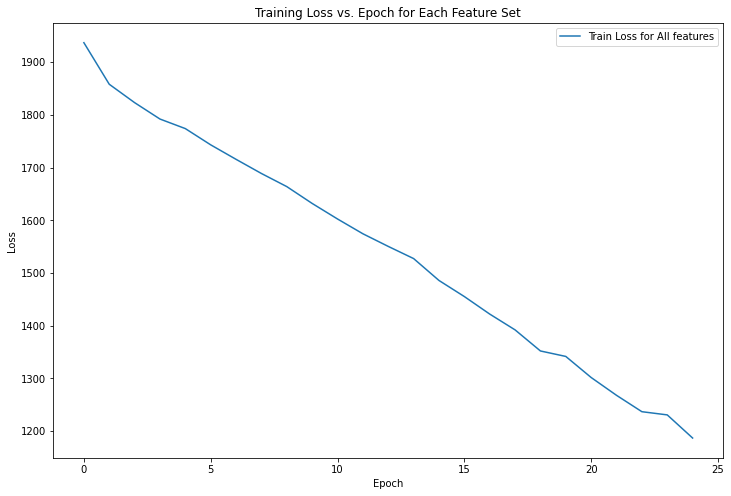

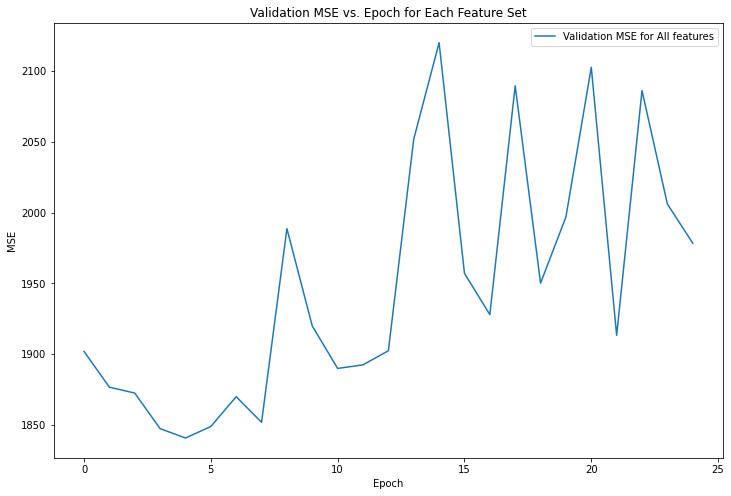

All features Training loss = 34.449799541638335       Validation loss = 42.90247018811606


In [0]:
import torch
from torch.utils.data import TensorDataset, DataLoader
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
hypertuning_hidden_size = [ 
    {'All features': [1024, 512, 256, 128]}]
num_epochs = 25 
feature_set_best_val_mse = {feature_set: float('inf') for feature_set in feature_set_name}  # Track best validation MSE
for feature_to_hidden in hypertuning_hidden_size:
    feature_set_losses, feature_set_val_mse  = {}, {}
    for feature_set in feature_set_name:
        X_train, X_val = feature_tensors[feature_set]['X']
        y_train, y_val = feature_tensors[feature_set]['y']
        
        y_val = y_val.view(-1, 1)

        input_size = X_train.shape[1]
        model = RegressionNN(input_size, feature_to_hidden[feature_set])
        criterion = nn.MSELoss()
        optimizer = torch.optim.SGD(params=model.parameters(), lr=0.002)

        # DataLoader
        train_dataset = TensorDataset(X_train, y_train)
        train_loader = DataLoader(dataset=train_dataset, batch_size=32, shuffle=True)

        losses, val_mse = [], []
        # Training Loop
        for epoch in range(num_epochs):
            model.train()
            total_loss = 0
            for inputs, targets in train_loader:
                optimizer.zero_grad()
                outputs = model(inputs)
                targets = targets.view(-1, 1)
                loss = criterion(outputs, targets)
                loss.backward()
                optimizer.step()
                total_loss += loss.item()
            average_loss = total_loss / len(train_loader)
            losses.append(average_loss)
            # Evaluation
            model.eval()
            with torch.no_grad():
                predictions = model(X_val).view(-1, 1).squeeze()
                y_val_squeezed = y_val.squeeze()  # Ensure y_val is properly squeezed for MSE calculation
                mse = mean_squared_error(y_val_squeezed.numpy(), predictions.numpy())
                val_mse.append(mse)

            current_mse = min(val_mse)
            if current_mse < feature_set_best_val_mse[feature_set]:
                feature_set_best_val_mse[feature_set] = current_mse
                # Define model filename with feature set and hidden layer dimensions
                model_filename = f"model_{feature_set.replace(' ', '_')}_{'-'.join(map(str, feature_to_hidden[feature_set]))}.pth"
                # Save the model's state dictionary
                torch.save(model.state_dict(), model_filename)
                print(f"Saved new best model with MSE {current_mse:.4f} as {model_filename}")

        feature_set_losses[feature_set] = losses
        feature_set_val_mse[feature_set] = val_mse   
    print(feature_to_hidden)
    # Plotting the loss for each feature set
    plt.figure(figsize=(12, 8))
    for feature_set, losses in feature_set_losses.items():
        plt.plot(losses, label=f'Train Loss for {feature_set}')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training Loss vs. Epoch for Each Feature Set')
    plt.legend()
    plt.show()

    # Plotting the MSE on the validation set for each feature set
    plt.figure(figsize=(12, 8))
    for feature_set, mse in feature_set_val_mse.items():
        plt.plot(mse, label=f'Validation MSE for {feature_set}')
    plt.xlabel('Epoch')
    plt.ylabel('MSE')
    plt.title('Validation MSE vs. Epoch for Each Feature Set')
    plt.legend()
    plt.show()

    for feature_set in feature_set_name:
        print(f"{feature_set} Training loss = {min(feature_set_losses[feature_set]) ** 0.5}       Validation loss = {min(feature_set_val_mse[feature_set]) ** 0.5}")
    print("=====================================================================================")

In [0]:
y_pred_fused = np.mean([y_pred, predictions.numpy()], axis=0)
rmse = sqrt(mean_squared_error(y_val, y_pred_fused))
print("Root Mean Squared Error (RMSE):", rmse)

# Display predicted values next to ground truth values
fused_predictions = pd.DataFrame({'Ground Truth': y_val.squeeze().numpy(), 'Predicted Values': y_pred_fused})
display(fused_predictions)

Root Mean Squared Error (RMSE): 42.8036629793891


Ground Truth,Predicted Values
9.0,15.425921
24.0,71.70846
14.0,24.530083
24.0,24.499348
17.0,27.360603
21.0,26.242653
12.0,14.064594
48.0,38.39798
114.0,96.71629
72.0,35.835007
